# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

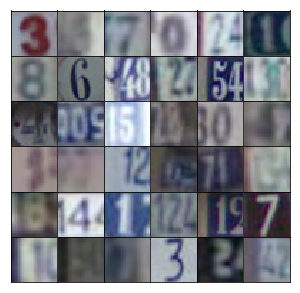

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)

for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [ ]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.001
batch_size = 128
epochs = 24
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/24... Discriminator Loss: 0.0846... Generator Loss: 15.9351
Epoch 1/24... Discriminator Loss: 0.0244... Generator Loss: 5.9348
Epoch 1/24... Discriminator Loss: 0.0716... Generator Loss: 20.2253
Epoch 1/24... Discriminator Loss: 0.5459... Generator Loss: 1.3941
Epoch 1/24... Discriminator Loss: 0.9931... Generator Loss: 2.1962
Epoch 1/24... Discriminator Loss: 0.9086... Generator Loss: 1.1106
Epoch 1/24... Discriminator Loss: 0.5166... Generator Loss: 2.0583
Epoch 1/24... Discriminator Loss: 0.5055... Generator Loss: 1.5350
Epoch 1/24... Discriminator Loss: 1.8685... Generator Loss: 0.2815
Epoch 1/24... Discriminator Loss: 0.5096... Generator Loss: 1.4447


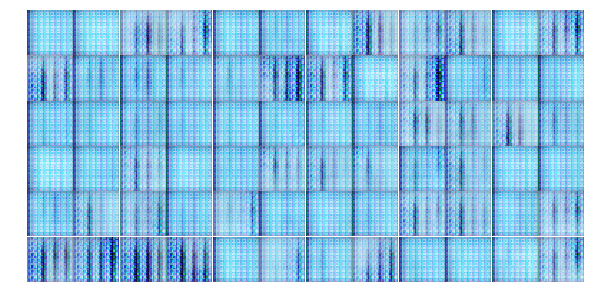

Epoch 1/24... Discriminator Loss: 1.6643... Generator Loss: 2.5170
Epoch 1/24... Discriminator Loss: 2.3757... Generator Loss: 0.1810
Epoch 1/24... Discriminator Loss: 1.1671... Generator Loss: 2.6706
Epoch 1/24... Discriminator Loss: 0.7104... Generator Loss: 1.8193
Epoch 1/24... Discriminator Loss: 1.5163... Generator Loss: 1.7592
Epoch 1/24... Discriminator Loss: 0.9187... Generator Loss: 2.2043
Epoch 1/24... Discriminator Loss: 1.1855... Generator Loss: 1.2267
Epoch 1/24... Discriminator Loss: 1.0542... Generator Loss: 0.9332
Epoch 1/24... Discriminator Loss: 0.5491... Generator Loss: 1.2357
Epoch 1/24... Discriminator Loss: 0.6422... Generator Loss: 1.2227


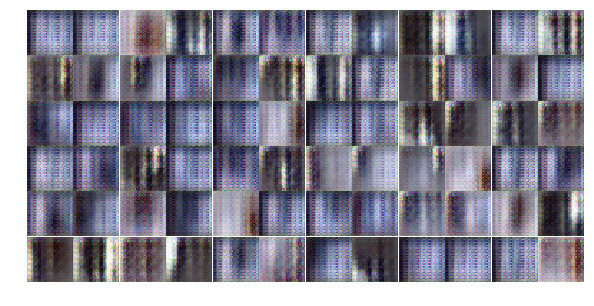

Epoch 1/24... Discriminator Loss: 1.0910... Generator Loss: 0.5559
Epoch 1/24... Discriminator Loss: 1.1426... Generator Loss: 1.0797
Epoch 1/24... Discriminator Loss: 1.4591... Generator Loss: 0.5726
Epoch 1/24... Discriminator Loss: 1.1685... Generator Loss: 0.9084
Epoch 1/24... Discriminator Loss: 1.3627... Generator Loss: 2.1294
Epoch 1/24... Discriminator Loss: 1.0981... Generator Loss: 0.9414
Epoch 1/24... Discriminator Loss: 0.5991... Generator Loss: 1.3273
Epoch 1/24... Discriminator Loss: 0.5720... Generator Loss: 1.6893
Epoch 1/24... Discriminator Loss: 0.5459... Generator Loss: 1.3183
Epoch 1/24... Discriminator Loss: 1.1177... Generator Loss: 1.1554


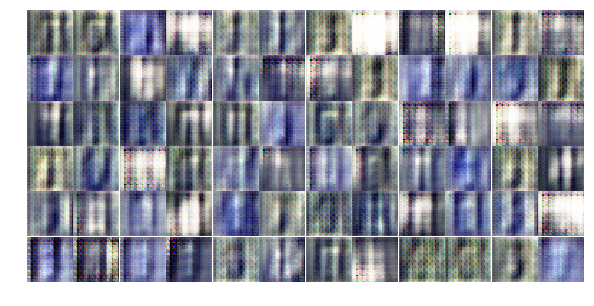

Epoch 1/24... Discriminator Loss: 1.2194... Generator Loss: 0.6962
Epoch 1/24... Discriminator Loss: 1.1234... Generator Loss: 0.8469
Epoch 1/24... Discriminator Loss: 1.1404... Generator Loss: 1.0330
Epoch 1/24... Discriminator Loss: 1.2381... Generator Loss: 0.8221
Epoch 1/24... Discriminator Loss: 1.2849... Generator Loss: 0.8413
Epoch 1/24... Discriminator Loss: 1.1589... Generator Loss: 0.9386
Epoch 1/24... Discriminator Loss: 0.9638... Generator Loss: 1.2314
Epoch 1/24... Discriminator Loss: 2.0777... Generator Loss: 3.6956
Epoch 1/24... Discriminator Loss: 0.9938... Generator Loss: 0.9072
Epoch 1/24... Discriminator Loss: 0.8935... Generator Loss: 1.2320


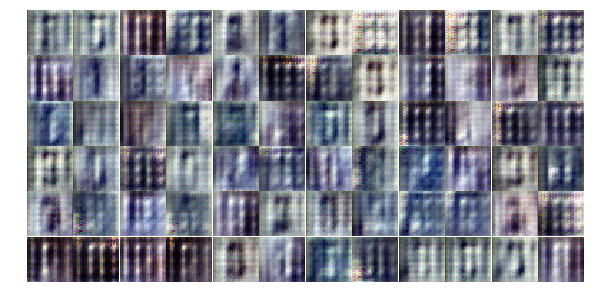

Epoch 1/24... Discriminator Loss: 0.6853... Generator Loss: 3.0312
Epoch 1/24... Discriminator Loss: 1.1543... Generator Loss: 1.1965
Epoch 1/24... Discriminator Loss: 1.4086... Generator Loss: 0.7048
Epoch 1/24... Discriminator Loss: 1.3629... Generator Loss: 0.9800
Epoch 1/24... Discriminator Loss: 1.1985... Generator Loss: 0.8016
Epoch 1/24... Discriminator Loss: 1.2418... Generator Loss: 1.0663
Epoch 1/24... Discriminator Loss: 0.5485... Generator Loss: 1.9768
Epoch 1/24... Discriminator Loss: 1.3636... Generator Loss: 0.5095
Epoch 1/24... Discriminator Loss: 2.1573... Generator Loss: 3.1115
Epoch 1/24... Discriminator Loss: 1.5777... Generator Loss: 0.8388


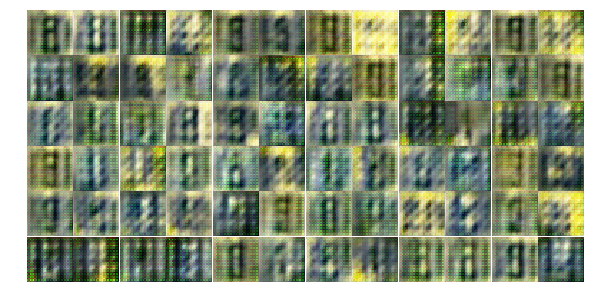

Epoch 1/24... Discriminator Loss: 0.8794... Generator Loss: 0.9277
Epoch 1/24... Discriminator Loss: 1.2819... Generator Loss: 0.8633
Epoch 1/24... Discriminator Loss: 1.4626... Generator Loss: 1.5999
Epoch 1/24... Discriminator Loss: 1.4445... Generator Loss: 0.7022
Epoch 1/24... Discriminator Loss: 1.3120... Generator Loss: 0.6924
Epoch 1/24... Discriminator Loss: 0.4607... Generator Loss: 1.9521
Epoch 1/24... Discriminator Loss: 1.0515... Generator Loss: 0.6782
Epoch 2/24... Discriminator Loss: 1.5167... Generator Loss: 0.9769
Epoch 2/24... Discriminator Loss: 1.1699... Generator Loss: 1.1847
Epoch 2/24... Discriminator Loss: 1.2194... Generator Loss: 0.6952


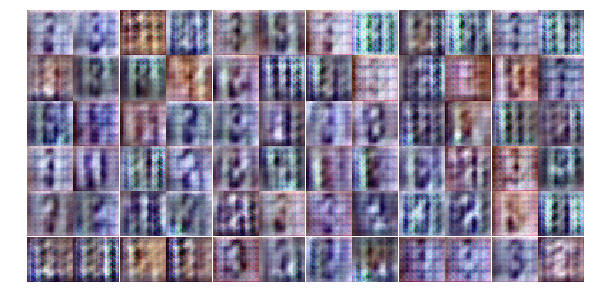

Epoch 2/24... Discriminator Loss: 0.7009... Generator Loss: 1.0706
Epoch 2/24... Discriminator Loss: 1.3050... Generator Loss: 0.6220
Epoch 2/24... Discriminator Loss: 1.2489... Generator Loss: 0.6936
Epoch 2/24... Discriminator Loss: 3.1303... Generator Loss: 4.1210
Epoch 2/24... Discriminator Loss: 1.3287... Generator Loss: 0.7298
Epoch 2/24... Discriminator Loss: 1.2873... Generator Loss: 0.9927
Epoch 2/24... Discriminator Loss: 1.3689... Generator Loss: 0.6776
Epoch 2/24... Discriminator Loss: 1.3842... Generator Loss: 0.8141
Epoch 2/24... Discriminator Loss: 1.0427... Generator Loss: 0.9086
Epoch 2/24... Discriminator Loss: 1.2609... Generator Loss: 2.0474


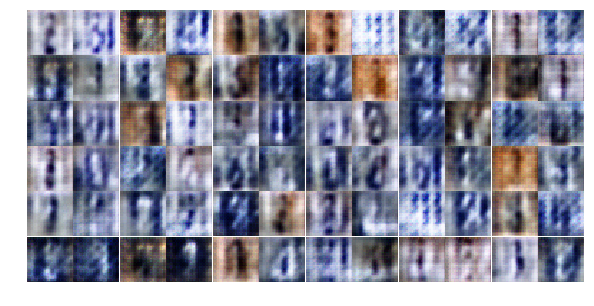

Epoch 2/24... Discriminator Loss: 1.1261... Generator Loss: 1.3523
Epoch 2/24... Discriminator Loss: 1.0100... Generator Loss: 1.0689
Epoch 2/24... Discriminator Loss: 1.4321... Generator Loss: 0.8776
Epoch 2/24... Discriminator Loss: 0.6029... Generator Loss: 1.3431
Epoch 2/24... Discriminator Loss: 1.2482... Generator Loss: 0.5635
Epoch 2/24... Discriminator Loss: 1.5650... Generator Loss: 0.7294
Epoch 2/24... Discriminator Loss: 1.2046... Generator Loss: 0.8556
Epoch 2/24... Discriminator Loss: 0.9109... Generator Loss: 1.0389
Epoch 2/24... Discriminator Loss: 1.1362... Generator Loss: 0.8872
Epoch 2/24... Discriminator Loss: 1.1852... Generator Loss: 0.7949


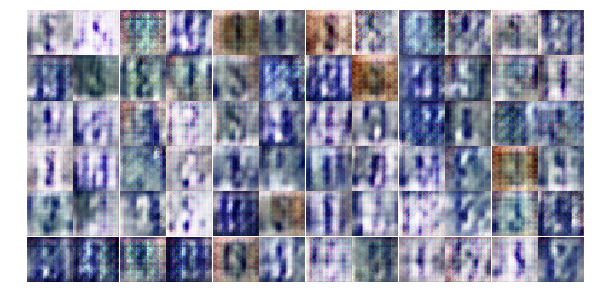

Epoch 2/24... Discriminator Loss: 1.0719... Generator Loss: 0.9710
Epoch 2/24... Discriminator Loss: 1.2724... Generator Loss: 0.7573
Epoch 2/24... Discriminator Loss: 1.0705... Generator Loss: 1.1125
Epoch 2/24... Discriminator Loss: 1.2597... Generator Loss: 0.7108
Epoch 2/24... Discriminator Loss: 1.2206... Generator Loss: 0.8891
Epoch 2/24... Discriminator Loss: 1.2626... Generator Loss: 1.6415
Epoch 2/24... Discriminator Loss: 1.1139... Generator Loss: 1.3652
Epoch 2/24... Discriminator Loss: 1.1947... Generator Loss: 0.9228
Epoch 2/24... Discriminator Loss: 1.2095... Generator Loss: 0.6850
Epoch 2/24... Discriminator Loss: 1.8711... Generator Loss: 2.6948


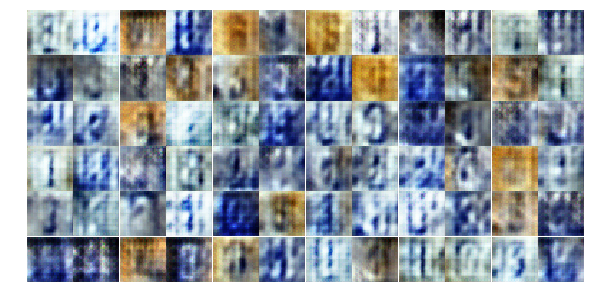

Epoch 2/24... Discriminator Loss: 1.4757... Generator Loss: 0.6549
Epoch 2/24... Discriminator Loss: 1.3545... Generator Loss: 0.8206
Epoch 2/24... Discriminator Loss: 1.2312... Generator Loss: 1.0562
Epoch 2/24... Discriminator Loss: 1.4218... Generator Loss: 0.6732
Epoch 2/24... Discriminator Loss: 1.1612... Generator Loss: 1.3438
Epoch 2/24... Discriminator Loss: 1.1539... Generator Loss: 0.9479
Epoch 2/24... Discriminator Loss: 1.1956... Generator Loss: 1.0396
Epoch 2/24... Discriminator Loss: 0.8469... Generator Loss: 1.3846
Epoch 2/24... Discriminator Loss: 1.3165... Generator Loss: 0.9866
Epoch 2/24... Discriminator Loss: 1.3468... Generator Loss: 0.6588


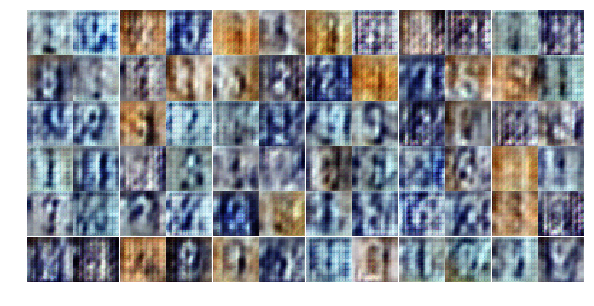

Epoch 2/24... Discriminator Loss: 1.2605... Generator Loss: 1.3328
Epoch 2/24... Discriminator Loss: 1.0345... Generator Loss: 1.0625
Epoch 2/24... Discriminator Loss: 1.2031... Generator Loss: 0.9926
Epoch 2/24... Discriminator Loss: 1.0575... Generator Loss: 0.9787
Epoch 2/24... Discriminator Loss: 1.4686... Generator Loss: 0.8954
Epoch 2/24... Discriminator Loss: 1.0993... Generator Loss: 1.0565
Epoch 2/24... Discriminator Loss: 1.1108... Generator Loss: 0.9349
Epoch 2/24... Discriminator Loss: 1.3786... Generator Loss: 0.6314
Epoch 2/24... Discriminator Loss: 1.0968... Generator Loss: 0.9969
Epoch 2/24... Discriminator Loss: 0.9852... Generator Loss: 1.0726


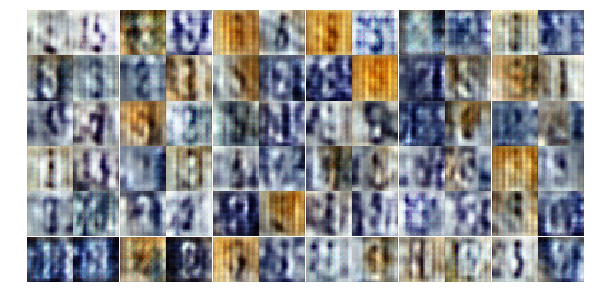

Epoch 2/24... Discriminator Loss: 1.2785... Generator Loss: 0.7351
Epoch 2/24... Discriminator Loss: 1.0428... Generator Loss: 0.9263
Epoch 2/24... Discriminator Loss: 1.0876... Generator Loss: 0.9150
Epoch 2/24... Discriminator Loss: 1.2511... Generator Loss: 1.0996
Epoch 3/24... Discriminator Loss: 1.0330... Generator Loss: 1.1652
Epoch 3/24... Discriminator Loss: 1.2475... Generator Loss: 0.6904
Epoch 3/24... Discriminator Loss: 1.3581... Generator Loss: 0.7861
Epoch 3/24... Discriminator Loss: 1.4076... Generator Loss: 0.7165
Epoch 3/24... Discriminator Loss: 1.0569... Generator Loss: 1.0194
Epoch 3/24... Discriminator Loss: 1.0414... Generator Loss: 1.0083


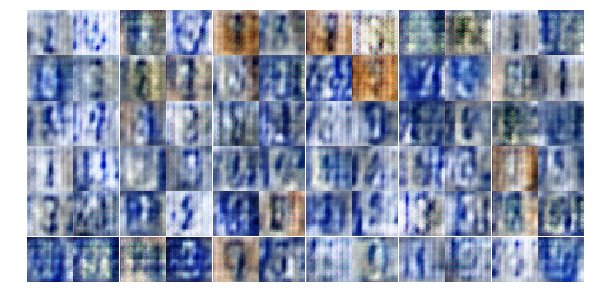

Epoch 3/24... Discriminator Loss: 1.4526... Generator Loss: 0.5933
Epoch 3/24... Discriminator Loss: 1.3604... Generator Loss: 0.6685
Epoch 3/24... Discriminator Loss: 1.3328... Generator Loss: 0.8278
Epoch 3/24... Discriminator Loss: 1.0797... Generator Loss: 1.0693
Epoch 3/24... Discriminator Loss: 1.3924... Generator Loss: 0.6096
Epoch 3/24... Discriminator Loss: 2.7315... Generator Loss: 4.1832
Epoch 3/24... Discriminator Loss: 1.2682... Generator Loss: 0.9905
Epoch 3/24... Discriminator Loss: 1.1829... Generator Loss: 1.3932
Epoch 3/24... Discriminator Loss: 1.1519... Generator Loss: 0.8843
Epoch 3/24... Discriminator Loss: 1.3104... Generator Loss: 0.7589


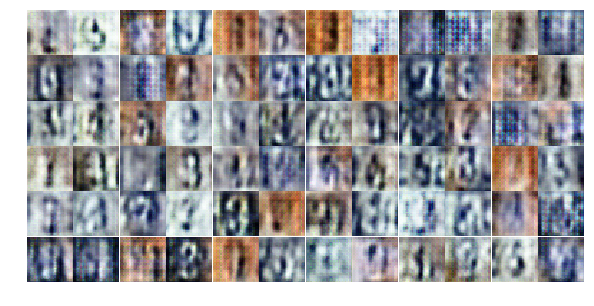

Epoch 3/24... Discriminator Loss: 1.1850... Generator Loss: 0.9011
Epoch 3/24... Discriminator Loss: 1.3791... Generator Loss: 0.6181
Epoch 3/24... Discriminator Loss: 1.2794... Generator Loss: 0.7638
Epoch 3/24... Discriminator Loss: 1.2256... Generator Loss: 0.8246
Epoch 3/24... Discriminator Loss: 1.2580... Generator Loss: 0.7907
Epoch 3/24... Discriminator Loss: 1.3313... Generator Loss: 0.8920
Epoch 3/24... Discriminator Loss: 1.2958... Generator Loss: 0.5400
Epoch 3/24... Discriminator Loss: 1.1821... Generator Loss: 0.7932
Epoch 3/24... Discriminator Loss: 1.3700... Generator Loss: 1.0537
Epoch 3/24... Discriminator Loss: 1.1287... Generator Loss: 0.9954


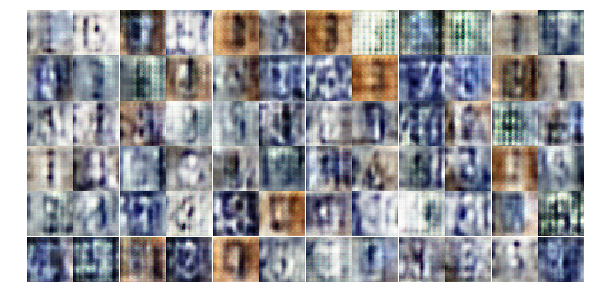

Epoch 3/24... Discriminator Loss: 1.3277... Generator Loss: 0.9266
Epoch 3/24... Discriminator Loss: 1.1813... Generator Loss: 0.9716
Epoch 3/24... Discriminator Loss: 1.2975... Generator Loss: 0.8598
Epoch 3/24... Discriminator Loss: 0.8953... Generator Loss: 0.9716
Epoch 3/24... Discriminator Loss: 1.1945... Generator Loss: 1.3909
Epoch 3/24... Discriminator Loss: 1.2466... Generator Loss: 0.7627
Epoch 3/24... Discriminator Loss: 1.2615... Generator Loss: 0.8532
Epoch 3/24... Discriminator Loss: 1.3497... Generator Loss: 0.7945
Epoch 3/24... Discriminator Loss: 1.4063... Generator Loss: 0.7662
Epoch 3/24... Discriminator Loss: 1.3489... Generator Loss: 0.7493


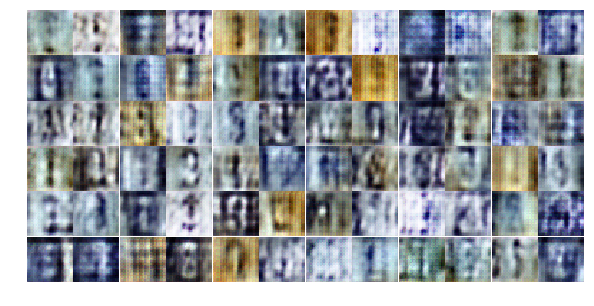

Epoch 3/24... Discriminator Loss: 1.3168... Generator Loss: 0.8964
Epoch 3/24... Discriminator Loss: 1.2957... Generator Loss: 0.8435
Epoch 3/24... Discriminator Loss: 1.3836... Generator Loss: 1.0133
Epoch 3/24... Discriminator Loss: 1.2804... Generator Loss: 0.8005
Epoch 3/24... Discriminator Loss: 1.2707... Generator Loss: 0.9653
Epoch 3/24... Discriminator Loss: 1.1618... Generator Loss: 0.8121
Epoch 3/24... Discriminator Loss: 1.3228... Generator Loss: 0.8921
Epoch 3/24... Discriminator Loss: 1.2336... Generator Loss: 0.9147
Epoch 3/24... Discriminator Loss: 1.2756... Generator Loss: 1.0544
Epoch 3/24... Discriminator Loss: 1.2580... Generator Loss: 0.8314


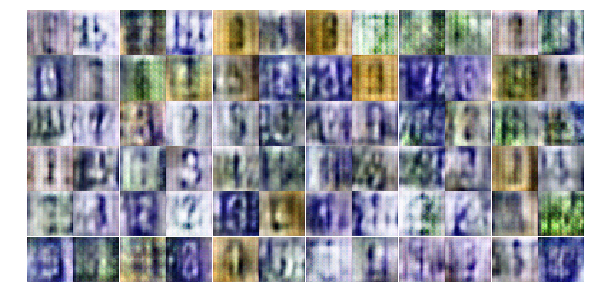

Epoch 3/24... Discriminator Loss: 1.2536... Generator Loss: 0.6878
Epoch 3/24... Discriminator Loss: 1.0965... Generator Loss: 1.3481
Epoch 3/24... Discriminator Loss: 1.1719... Generator Loss: 0.8671
Epoch 3/24... Discriminator Loss: 1.0862... Generator Loss: 1.0106
Epoch 3/24... Discriminator Loss: 1.3397... Generator Loss: 1.1075
Epoch 3/24... Discriminator Loss: 1.1749... Generator Loss: 1.0064
Epoch 3/24... Discriminator Loss: 1.1942... Generator Loss: 0.7362
Epoch 3/24... Discriminator Loss: 1.2015... Generator Loss: 0.8727
Epoch 3/24... Discriminator Loss: 1.3410... Generator Loss: 0.7481
Epoch 3/24... Discriminator Loss: 1.3849... Generator Loss: 0.9071


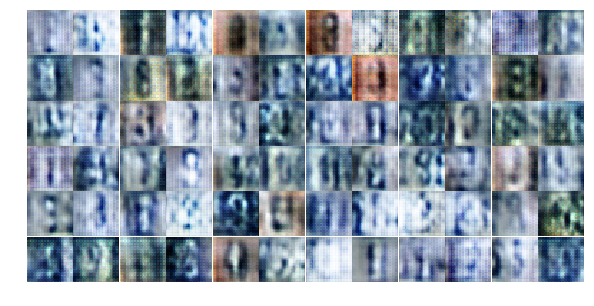

Epoch 3/24... Discriminator Loss: 1.5260... Generator Loss: 0.5602
Epoch 4/24... Discriminator Loss: 1.3910... Generator Loss: 1.0327
Epoch 4/24... Discriminator Loss: 1.1407... Generator Loss: 0.8599
Epoch 4/24... Discriminator Loss: 1.0579... Generator Loss: 0.8073
Epoch 4/24... Discriminator Loss: 1.1008... Generator Loss: 0.9960
Epoch 4/24... Discriminator Loss: 1.3810... Generator Loss: 0.7485
Epoch 4/24... Discriminator Loss: 1.2405... Generator Loss: 0.7303
Epoch 4/24... Discriminator Loss: 0.9493... Generator Loss: 1.4213
Epoch 4/24... Discriminator Loss: 1.2243... Generator Loss: 0.7988
Epoch 4/24... Discriminator Loss: 1.1922... Generator Loss: 0.7228


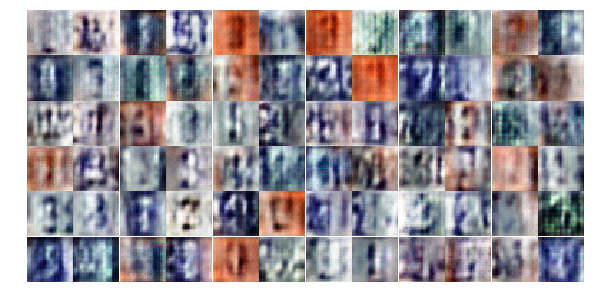

Epoch 4/24... Discriminator Loss: 1.1947... Generator Loss: 0.6642
Epoch 4/24... Discriminator Loss: 1.1745... Generator Loss: 0.7039
Epoch 4/24... Discriminator Loss: 1.2991... Generator Loss: 1.0540
Epoch 4/24... Discriminator Loss: 1.3184... Generator Loss: 0.6826
Epoch 4/24... Discriminator Loss: 1.2606... Generator Loss: 0.8209
Epoch 4/24... Discriminator Loss: 1.5415... Generator Loss: 0.4107
Epoch 4/24... Discriminator Loss: 1.3174... Generator Loss: 0.6788
Epoch 4/24... Discriminator Loss: 1.3861... Generator Loss: 0.7753
Epoch 4/24... Discriminator Loss: 1.2573... Generator Loss: 0.9819
Epoch 4/24... Discriminator Loss: 1.1052... Generator Loss: 0.7971


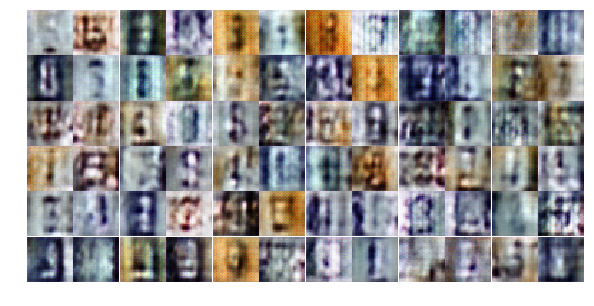

Epoch 4/24... Discriminator Loss: 1.2137... Generator Loss: 0.6436
Epoch 4/24... Discriminator Loss: 1.2094... Generator Loss: 0.8728
Epoch 4/24... Discriminator Loss: 0.6884... Generator Loss: 2.0146
Epoch 4/24... Discriminator Loss: 1.1437... Generator Loss: 1.0076
Epoch 4/24... Discriminator Loss: 1.2456... Generator Loss: 1.0014
Epoch 4/24... Discriminator Loss: 1.1076... Generator Loss: 1.3208
Epoch 4/24... Discriminator Loss: 1.1999... Generator Loss: 0.8079
Epoch 4/24... Discriminator Loss: 1.1577... Generator Loss: 0.9701
Epoch 4/24... Discriminator Loss: 1.4982... Generator Loss: 0.4771
Epoch 4/24... Discriminator Loss: 1.2872... Generator Loss: 0.6030


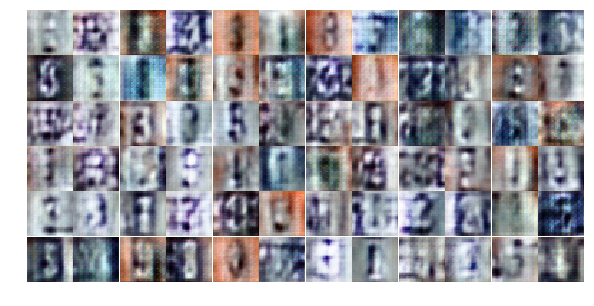

Epoch 4/24... Discriminator Loss: 0.9171... Generator Loss: 1.1824
Epoch 4/24... Discriminator Loss: 1.3163... Generator Loss: 0.7724
Epoch 4/24... Discriminator Loss: 0.5949... Generator Loss: 1.0068
Epoch 4/24... Discriminator Loss: 1.0910... Generator Loss: 0.7874
Epoch 4/24... Discriminator Loss: 1.5292... Generator Loss: 1.5413
Epoch 4/24... Discriminator Loss: 1.2469... Generator Loss: 0.8653
Epoch 4/24... Discriminator Loss: 1.2575... Generator Loss: 0.7226
Epoch 4/24... Discriminator Loss: 0.8706... Generator Loss: 0.9146
Epoch 4/24... Discriminator Loss: 1.1165... Generator Loss: 0.8934
Epoch 4/24... Discriminator Loss: 1.6439... Generator Loss: 0.3735


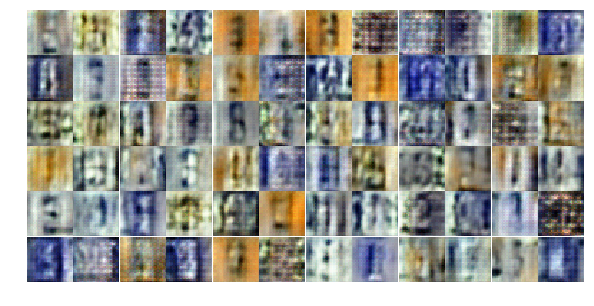

Epoch 4/24... Discriminator Loss: 1.0246... Generator Loss: 1.0008
Epoch 4/24... Discriminator Loss: 1.0521... Generator Loss: 0.9063
Epoch 4/24... Discriminator Loss: 0.7957... Generator Loss: 0.9463
Epoch 4/24... Discriminator Loss: 1.0014... Generator Loss: 0.9913
Epoch 4/24... Discriminator Loss: 1.0302... Generator Loss: 1.0308
Epoch 4/24... Discriminator Loss: 0.9499... Generator Loss: 1.1030
Epoch 4/24... Discriminator Loss: 1.0436... Generator Loss: 1.2250
Epoch 4/24... Discriminator Loss: 1.0362... Generator Loss: 1.1246
Epoch 4/24... Discriminator Loss: 1.1729... Generator Loss: 0.8066
Epoch 4/24... Discriminator Loss: 1.1354... Generator Loss: 1.1445


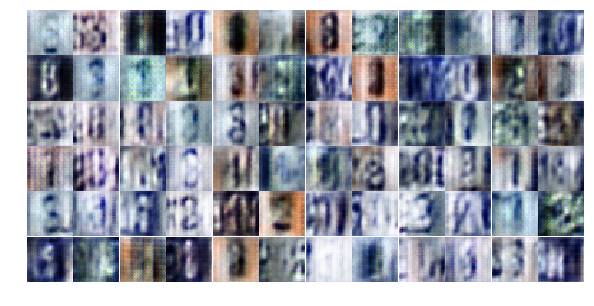

Epoch 4/24... Discriminator Loss: 1.0951... Generator Loss: 0.8694
Epoch 4/24... Discriminator Loss: 1.6072... Generator Loss: 2.1128
Epoch 4/24... Discriminator Loss: 1.1231... Generator Loss: 0.9503
Epoch 4/24... Discriminator Loss: 1.1870... Generator Loss: 1.3027
Epoch 4/24... Discriminator Loss: 0.8936... Generator Loss: 1.1149
Epoch 4/24... Discriminator Loss: 1.0503... Generator Loss: 0.9152
Epoch 4/24... Discriminator Loss: 1.0693... Generator Loss: 0.7590
Epoch 4/24... Discriminator Loss: 1.0939... Generator Loss: 0.9792
Epoch 4/24... Discriminator Loss: 1.8247... Generator Loss: 2.3839
Epoch 5/24... Discriminator Loss: 1.2980... Generator Loss: 0.5873


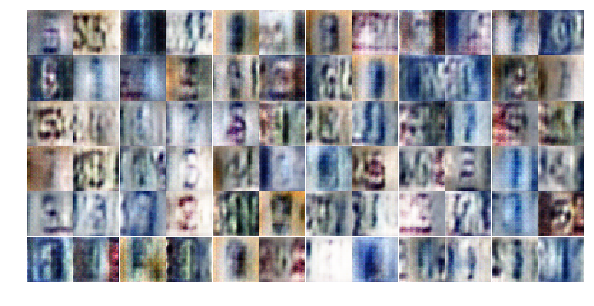

Epoch 5/24... Discriminator Loss: 1.0028... Generator Loss: 0.8100
Epoch 5/24... Discriminator Loss: 1.1794... Generator Loss: 0.6210
Epoch 5/24... Discriminator Loss: 0.7574... Generator Loss: 1.5135
Epoch 5/24... Discriminator Loss: 1.5337... Generator Loss: 0.3404
Epoch 5/24... Discriminator Loss: 0.9346... Generator Loss: 0.8155
Epoch 5/24... Discriminator Loss: 1.2646... Generator Loss: 0.6319
Epoch 5/24... Discriminator Loss: 2.1391... Generator Loss: 0.1710
Epoch 5/24... Discriminator Loss: 0.7326... Generator Loss: 1.5888
Epoch 5/24... Discriminator Loss: 0.7459... Generator Loss: 0.8545
Epoch 5/24... Discriminator Loss: 1.1194... Generator Loss: 0.9151


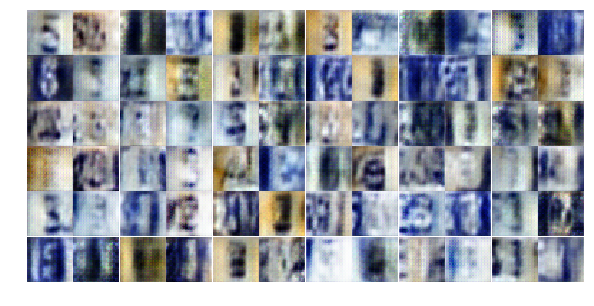

Epoch 5/24... Discriminator Loss: 1.0486... Generator Loss: 1.1533
Epoch 5/24... Discriminator Loss: 1.1061... Generator Loss: 1.8023
Epoch 5/24... Discriminator Loss: 1.2135... Generator Loss: 0.5693
Epoch 5/24... Discriminator Loss: 1.4010... Generator Loss: 0.6661
Epoch 5/24... Discriminator Loss: 1.2338... Generator Loss: 0.5598
Epoch 5/24... Discriminator Loss: 0.9903... Generator Loss: 0.7651
Epoch 5/24... Discriminator Loss: 0.8615... Generator Loss: 0.9779
Epoch 5/24... Discriminator Loss: 1.0470... Generator Loss: 2.0910
Epoch 5/24... Discriminator Loss: 1.2197... Generator Loss: 0.4777
Epoch 5/24... Discriminator Loss: 0.4843... Generator Loss: 2.2418


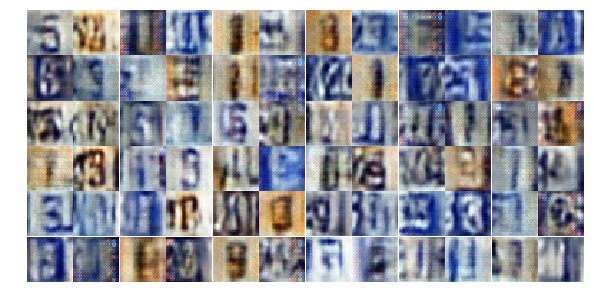

Epoch 5/24... Discriminator Loss: 1.0686... Generator Loss: 1.3337
Epoch 5/24... Discriminator Loss: 0.9232... Generator Loss: 1.0107
Epoch 5/24... Discriminator Loss: 0.5706... Generator Loss: 1.6105
Epoch 5/24... Discriminator Loss: 0.8841... Generator Loss: 1.0396
Epoch 5/24... Discriminator Loss: 2.1661... Generator Loss: 0.1603
Epoch 5/24... Discriminator Loss: 0.6752... Generator Loss: 1.1580
Epoch 5/24... Discriminator Loss: 1.8476... Generator Loss: 3.8292
Epoch 5/24... Discriminator Loss: 0.8380... Generator Loss: 0.9751
Epoch 5/24... Discriminator Loss: 0.6800... Generator Loss: 4.7997
Epoch 5/24... Discriminator Loss: 1.4738... Generator Loss: 7.0250


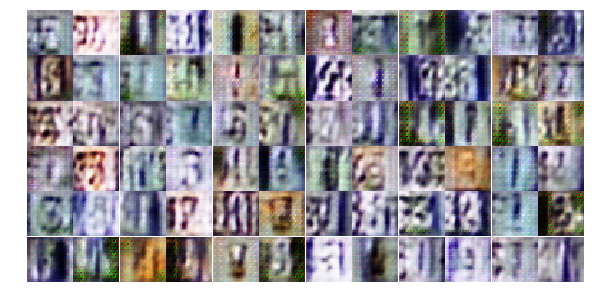

Epoch 5/24... Discriminator Loss: 0.6833... Generator Loss: 1.5847
Epoch 5/24... Discriminator Loss: 0.2118... Generator Loss: 3.8714
Epoch 5/24... Discriminator Loss: 0.2598... Generator Loss: 1.8594
Epoch 5/24... Discriminator Loss: 1.1109... Generator Loss: 1.5328
Epoch 5/24... Discriminator Loss: 0.6418... Generator Loss: 0.9947
Epoch 5/24... Discriminator Loss: 0.2011... Generator Loss: 3.6466
Epoch 5/24... Discriminator Loss: 1.3023... Generator Loss: 0.8375
Epoch 5/24... Discriminator Loss: 0.9355... Generator Loss: 3.0026
Epoch 5/24... Discriminator Loss: 1.1454... Generator Loss: 0.5568
Epoch 5/24... Discriminator Loss: 0.9179... Generator Loss: 3.4649


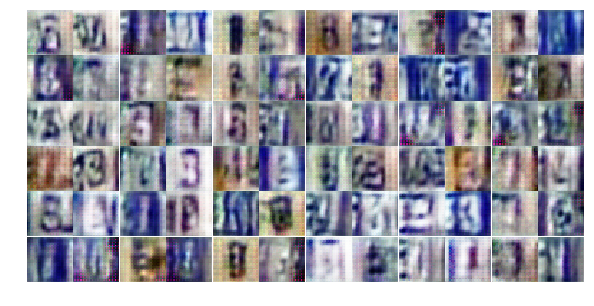

Epoch 5/24... Discriminator Loss: 0.8770... Generator Loss: 1.1792
Epoch 5/24... Discriminator Loss: 1.0085... Generator Loss: 0.6524
Epoch 5/24... Discriminator Loss: 1.3422... Generator Loss: 0.5683
Epoch 5/24... Discriminator Loss: 1.2788... Generator Loss: 0.8213
Epoch 5/24... Discriminator Loss: 0.7199... Generator Loss: 1.1398
Epoch 5/24... Discriminator Loss: 0.6732... Generator Loss: 2.0708
Epoch 5/24... Discriminator Loss: 0.9850... Generator Loss: 0.9110
Epoch 5/24... Discriminator Loss: 1.5592... Generator Loss: 2.8611
Epoch 5/24... Discriminator Loss: 0.5791... Generator Loss: 2.5388
Epoch 5/24... Discriminator Loss: 1.5867... Generator Loss: 1.7680


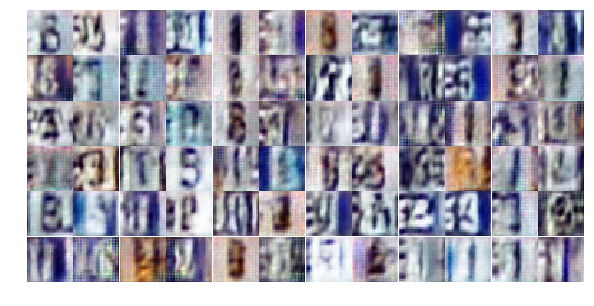

Epoch 5/24... Discriminator Loss: 2.1141... Generator Loss: 1.9970
Epoch 5/24... Discriminator Loss: 1.1063... Generator Loss: 0.9213
Epoch 5/24... Discriminator Loss: 1.6936... Generator Loss: 0.2704
Epoch 5/24... Discriminator Loss: 0.8192... Generator Loss: 1.0109
Epoch 5/24... Discriminator Loss: 1.0295... Generator Loss: 1.0524
Epoch 5/24... Discriminator Loss: 1.3137... Generator Loss: 0.5165
Epoch 6/24... Discriminator Loss: 1.0951... Generator Loss: 1.0919
Epoch 6/24... Discriminator Loss: 0.8179... Generator Loss: 1.1958
Epoch 6/24... Discriminator Loss: 0.4912... Generator Loss: 2.2213
Epoch 6/24... Discriminator Loss: 1.2806... Generator Loss: 0.9104


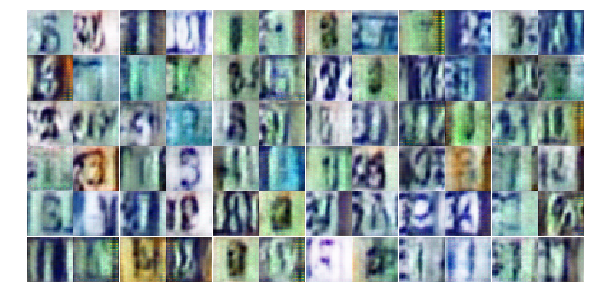

Epoch 6/24... Discriminator Loss: 1.0195... Generator Loss: 0.6093
Epoch 6/24... Discriminator Loss: 0.9037... Generator Loss: 0.7687
Epoch 6/24... Discriminator Loss: 1.5395... Generator Loss: 0.7254
Epoch 6/24... Discriminator Loss: 1.1178... Generator Loss: 0.8032
Epoch 6/24... Discriminator Loss: 1.1163... Generator Loss: 0.6317
Epoch 6/24... Discriminator Loss: 0.9664... Generator Loss: 0.6923
Epoch 6/24... Discriminator Loss: 1.8600... Generator Loss: 0.3017
Epoch 6/24... Discriminator Loss: 1.5049... Generator Loss: 0.4612
Epoch 6/24... Discriminator Loss: 0.8068... Generator Loss: 1.1594
Epoch 6/24... Discriminator Loss: 0.5998... Generator Loss: 1.3335


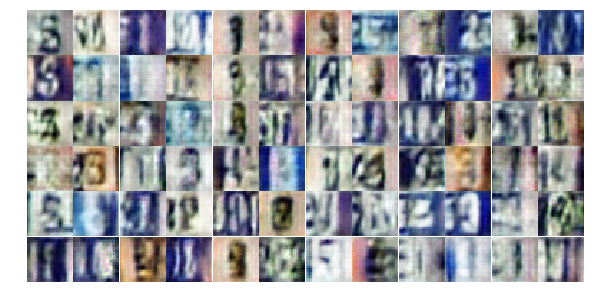

Epoch 6/24... Discriminator Loss: 1.1952... Generator Loss: 0.5896
Epoch 6/24... Discriminator Loss: 1.0151... Generator Loss: 0.8082
Epoch 6/24... Discriminator Loss: 1.1909... Generator Loss: 0.4787
Epoch 6/24... Discriminator Loss: 0.9274... Generator Loss: 2.0823
Epoch 6/24... Discriminator Loss: 0.8525... Generator Loss: 1.0820
Epoch 6/24... Discriminator Loss: 0.8081... Generator Loss: 1.9173
Epoch 6/24... Discriminator Loss: 1.2579... Generator Loss: 0.8425
Epoch 6/24... Discriminator Loss: 0.7414... Generator Loss: 1.3333
Epoch 6/24... Discriminator Loss: 1.0865... Generator Loss: 0.9605
Epoch 6/24... Discriminator Loss: 0.6853... Generator Loss: 1.6872


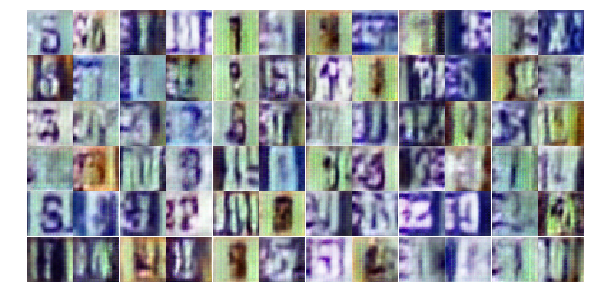

Epoch 6/24... Discriminator Loss: 2.3604... Generator Loss: 2.9066
Epoch 6/24... Discriminator Loss: 0.3922... Generator Loss: 1.8589
Epoch 6/24... Discriminator Loss: 1.2256... Generator Loss: 0.5677
Epoch 6/24... Discriminator Loss: 1.0240... Generator Loss: 0.9395
Epoch 6/24... Discriminator Loss: 1.6513... Generator Loss: 0.3845
Epoch 6/24... Discriminator Loss: 0.6129... Generator Loss: 1.2457
Epoch 6/24... Discriminator Loss: 1.5031... Generator Loss: 0.7780
Epoch 6/24... Discriminator Loss: 1.2573... Generator Loss: 0.7156
Epoch 6/24... Discriminator Loss: 1.1740... Generator Loss: 0.6717
Epoch 6/24... Discriminator Loss: 1.0670... Generator Loss: 0.8382


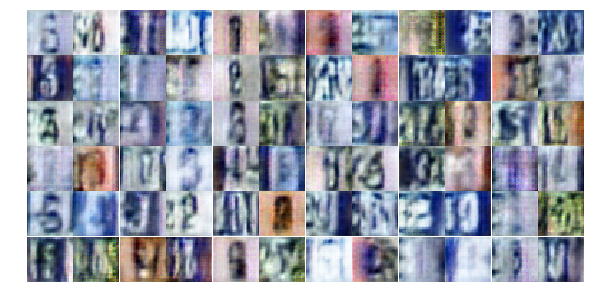

Epoch 6/24... Discriminator Loss: 0.8772... Generator Loss: 0.7827
Epoch 6/24... Discriminator Loss: 1.2440... Generator Loss: 0.6903
Epoch 6/24... Discriminator Loss: 0.9905... Generator Loss: 1.0304
Epoch 6/24... Discriminator Loss: 0.8959... Generator Loss: 1.0032
Epoch 6/24... Discriminator Loss: 1.0548... Generator Loss: 0.6382
Epoch 6/24... Discriminator Loss: 1.6566... Generator Loss: 0.9606
Epoch 6/24... Discriminator Loss: 0.2906... Generator Loss: 4.0583
Epoch 6/24... Discriminator Loss: 1.3499... Generator Loss: 0.7616
Epoch 6/24... Discriminator Loss: 1.2426... Generator Loss: 1.7168
Epoch 6/24... Discriminator Loss: 1.3009... Generator Loss: 0.4642


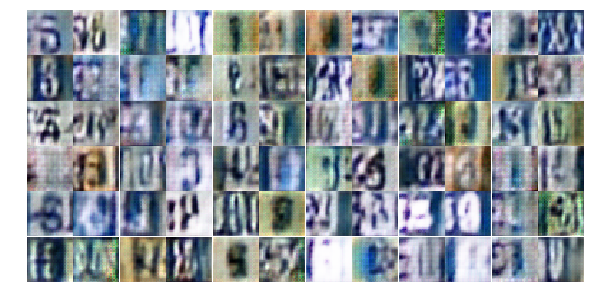

Epoch 6/24... Discriminator Loss: 1.2390... Generator Loss: 0.7179
Epoch 6/24... Discriminator Loss: 1.5718... Generator Loss: 0.4685
Epoch 6/24... Discriminator Loss: 1.4812... Generator Loss: 0.4129
Epoch 6/24... Discriminator Loss: 2.3994... Generator Loss: 2.5196
Epoch 6/24... Discriminator Loss: 0.9836... Generator Loss: 1.2909
Epoch 6/24... Discriminator Loss: 0.4390... Generator Loss: 1.6259
Epoch 6/24... Discriminator Loss: 1.1147... Generator Loss: 1.0091
Epoch 6/24... Discriminator Loss: 1.6813... Generator Loss: 0.2893
Epoch 6/24... Discriminator Loss: 1.0068... Generator Loss: 0.8323
Epoch 6/24... Discriminator Loss: 0.8093... Generator Loss: 1.0450


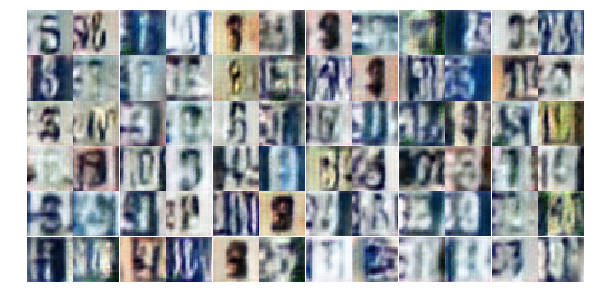

Epoch 6/24... Discriminator Loss: 1.7362... Generator Loss: 0.3354
Epoch 6/24... Discriminator Loss: 1.0208... Generator Loss: 0.7790
Epoch 6/24... Discriminator Loss: 1.2651... Generator Loss: 0.7899
Epoch 7/24... Discriminator Loss: 0.8959... Generator Loss: 1.1084
Epoch 7/24... Discriminator Loss: 0.9553... Generator Loss: 0.9101
Epoch 7/24... Discriminator Loss: 0.7416... Generator Loss: 1.6777
Epoch 7/24... Discriminator Loss: 0.7712... Generator Loss: 1.1670
Epoch 7/24... Discriminator Loss: 0.9743... Generator Loss: 0.8563
Epoch 7/24... Discriminator Loss: 1.0379... Generator Loss: 0.9032
Epoch 7/24... Discriminator Loss: 1.1178... Generator Loss: 0.7361


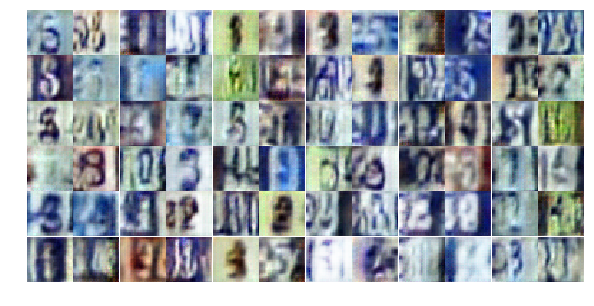

Epoch 7/24... Discriminator Loss: 1.0088... Generator Loss: 0.8167
Epoch 7/24... Discriminator Loss: 1.1222... Generator Loss: 0.5649
Epoch 7/24... Discriminator Loss: 1.0790... Generator Loss: 0.6773
Epoch 7/24... Discriminator Loss: 2.2079... Generator Loss: 0.1871
Epoch 7/24... Discriminator Loss: 0.9479... Generator Loss: 0.8321
Epoch 7/24... Discriminator Loss: 0.6588... Generator Loss: 1.4611
Epoch 7/24... Discriminator Loss: 1.2127... Generator Loss: 0.6519
Epoch 7/24... Discriminator Loss: 0.8784... Generator Loss: 1.3080
Epoch 7/24... Discriminator Loss: 1.3020... Generator Loss: 1.4810
Epoch 7/24... Discriminator Loss: 1.1553... Generator Loss: 1.0371


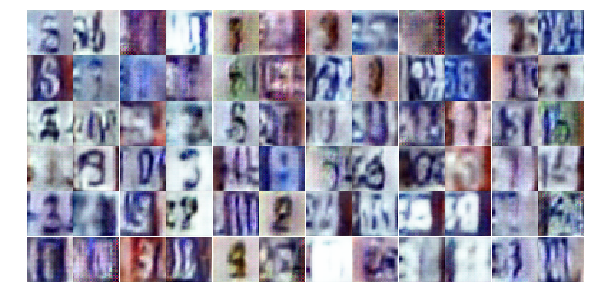

Epoch 7/24... Discriminator Loss: 0.9788... Generator Loss: 1.2022
Epoch 7/24... Discriminator Loss: 0.9840... Generator Loss: 1.2567
Epoch 7/24... Discriminator Loss: 1.6258... Generator Loss: 0.8268
Epoch 7/24... Discriminator Loss: 1.2301... Generator Loss: 1.0400
Epoch 7/24... Discriminator Loss: 1.1039... Generator Loss: 1.2963
Epoch 7/24... Discriminator Loss: 1.1750... Generator Loss: 0.8757
Epoch 7/24... Discriminator Loss: 1.1851... Generator Loss: 0.6391
Epoch 7/24... Discriminator Loss: 1.2786... Generator Loss: 0.7038
Epoch 7/24... Discriminator Loss: 0.9391... Generator Loss: 0.9942
Epoch 7/24... Discriminator Loss: 1.1807... Generator Loss: 0.8592


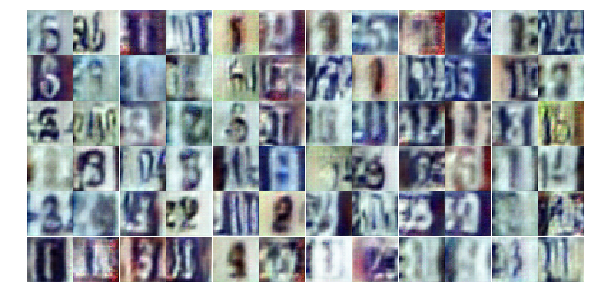

Epoch 7/24... Discriminator Loss: 1.3912... Generator Loss: 0.4140
Epoch 7/24... Discriminator Loss: 1.9242... Generator Loss: 0.2186
Epoch 7/24... Discriminator Loss: 1.2925... Generator Loss: 0.5432
Epoch 7/24... Discriminator Loss: 1.2471... Generator Loss: 0.6364
Epoch 7/24... Discriminator Loss: 1.1317... Generator Loss: 0.7556
Epoch 7/24... Discriminator Loss: 1.1676... Generator Loss: 0.5897
Epoch 7/24... Discriminator Loss: 0.9674... Generator Loss: 0.9446
Epoch 7/24... Discriminator Loss: 1.1925... Generator Loss: 0.8874
Epoch 7/24... Discriminator Loss: 1.5681... Generator Loss: 0.3445
Epoch 7/24... Discriminator Loss: 1.1804... Generator Loss: 0.8983


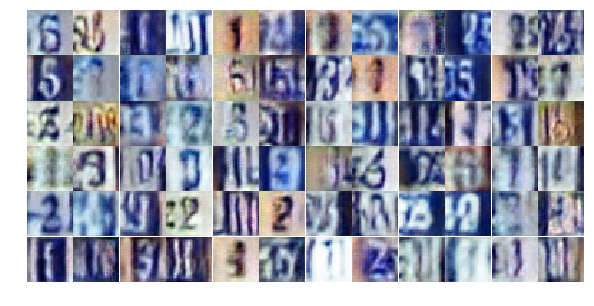

Epoch 7/24... Discriminator Loss: 1.3824... Generator Loss: 0.5158
Epoch 7/24... Discriminator Loss: 1.1903... Generator Loss: 0.5933
Epoch 7/24... Discriminator Loss: 1.4925... Generator Loss: 1.2862
Epoch 7/24... Discriminator Loss: 1.3006... Generator Loss: 0.4898
Epoch 7/24... Discriminator Loss: 0.6120... Generator Loss: 1.2792
Epoch 7/24... Discriminator Loss: 0.9415... Generator Loss: 1.0342
Epoch 7/24... Discriminator Loss: 1.0444... Generator Loss: 0.7357
Epoch 7/24... Discriminator Loss: 1.4315... Generator Loss: 0.4328
Epoch 7/24... Discriminator Loss: 1.1518... Generator Loss: 0.8398
Epoch 7/24... Discriminator Loss: 1.6354... Generator Loss: 0.3399


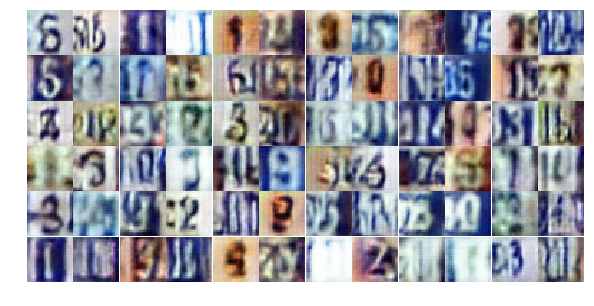

Epoch 7/24... Discriminator Loss: 0.7830... Generator Loss: 1.0619
Epoch 7/24... Discriminator Loss: 1.5573... Generator Loss: 0.3555
Epoch 7/24... Discriminator Loss: 0.7157... Generator Loss: 1.1511
Epoch 7/24... Discriminator Loss: 1.2224... Generator Loss: 1.1672
Epoch 7/24... Discriminator Loss: 1.1297... Generator Loss: 0.6965
Epoch 7/24... Discriminator Loss: 0.8264... Generator Loss: 1.6386
Epoch 7/24... Discriminator Loss: 1.4235... Generator Loss: 0.4020
Epoch 7/24... Discriminator Loss: 0.8952... Generator Loss: 2.1000
Epoch 7/24... Discriminator Loss: 1.1141... Generator Loss: 0.5933
Epoch 7/24... Discriminator Loss: 0.4907... Generator Loss: 1.3667


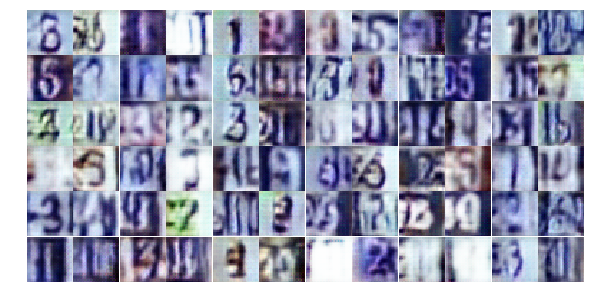

Epoch 7/24... Discriminator Loss: 1.2825... Generator Loss: 1.8261
Epoch 8/24... Discriminator Loss: 1.1340... Generator Loss: 1.1693
Epoch 8/24... Discriminator Loss: 1.1033... Generator Loss: 0.8396
Epoch 8/24... Discriminator Loss: 1.0857... Generator Loss: 0.8137
Epoch 8/24... Discriminator Loss: 1.1520... Generator Loss: 0.7147
Epoch 8/24... Discriminator Loss: 1.5141... Generator Loss: 0.4938
Epoch 8/24... Discriminator Loss: 1.2829... Generator Loss: 0.5651
Epoch 8/24... Discriminator Loss: 1.0633... Generator Loss: 0.8909
Epoch 8/24... Discriminator Loss: 1.1609... Generator Loss: 0.7696
Epoch 8/24... Discriminator Loss: 0.8760... Generator Loss: 0.6929


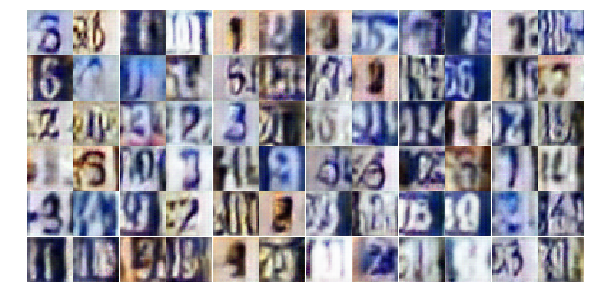

Epoch 8/24... Discriminator Loss: 1.1614... Generator Loss: 0.6623
Epoch 8/24... Discriminator Loss: 0.9892... Generator Loss: 0.6581
Epoch 8/24... Discriminator Loss: 1.7229... Generator Loss: 0.2668
Epoch 8/24... Discriminator Loss: 1.6673... Generator Loss: 0.3474
Epoch 8/24... Discriminator Loss: 1.2062... Generator Loss: 0.7183
Epoch 8/24... Discriminator Loss: 1.0944... Generator Loss: 0.9214
Epoch 8/24... Discriminator Loss: 1.2727... Generator Loss: 1.8913
Epoch 8/24... Discriminator Loss: 0.9934... Generator Loss: 0.8942
Epoch 8/24... Discriminator Loss: 0.8342... Generator Loss: 1.6374
Epoch 8/24... Discriminator Loss: 1.2968... Generator Loss: 0.5694


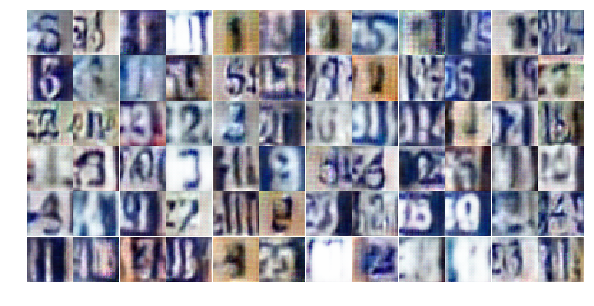

Epoch 8/24... Discriminator Loss: 1.0284... Generator Loss: 0.7450
Epoch 8/24... Discriminator Loss: 0.2026... Generator Loss: 2.4086
Epoch 8/24... Discriminator Loss: 1.0928... Generator Loss: 0.9964
Epoch 8/24... Discriminator Loss: 1.1985... Generator Loss: 0.7074
Epoch 8/24... Discriminator Loss: 0.5453... Generator Loss: 1.5856
Epoch 8/24... Discriminator Loss: 1.1644... Generator Loss: 1.2157
Epoch 8/24... Discriminator Loss: 1.1099... Generator Loss: 1.1593
Epoch 8/24... Discriminator Loss: 0.9513... Generator Loss: 0.9452
Epoch 8/24... Discriminator Loss: 1.2087... Generator Loss: 0.7133
Epoch 8/24... Discriminator Loss: 0.7001... Generator Loss: 1.2963


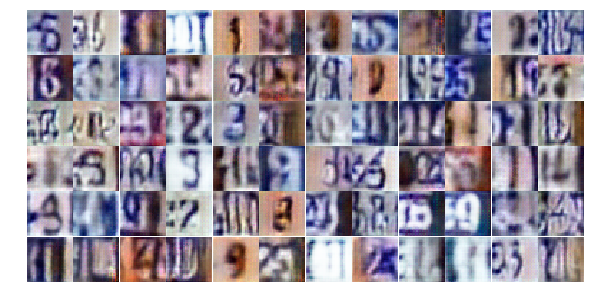

Epoch 8/24... Discriminator Loss: 0.3267... Generator Loss: 1.7641
Epoch 8/24... Discriminator Loss: 0.7411... Generator Loss: 1.7089
Epoch 8/24... Discriminator Loss: 0.9483... Generator Loss: 1.1358
Epoch 8/24... Discriminator Loss: 1.1991... Generator Loss: 0.5765
Epoch 8/24... Discriminator Loss: 0.5601... Generator Loss: 1.6057
Epoch 8/24... Discriminator Loss: 0.8815... Generator Loss: 0.9444
Epoch 8/24... Discriminator Loss: 0.9899... Generator Loss: 0.6649
Epoch 8/24... Discriminator Loss: 0.9667... Generator Loss: 0.7404
Epoch 8/24... Discriminator Loss: 1.0059... Generator Loss: 0.9069
Epoch 8/24... Discriminator Loss: 0.9404... Generator Loss: 1.3065


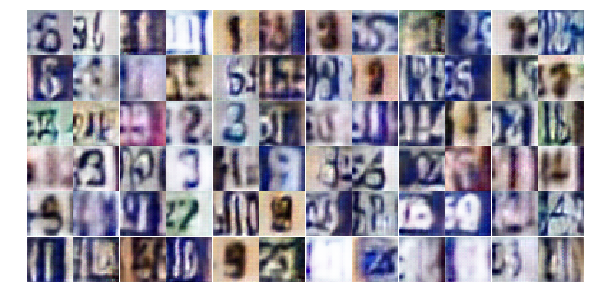

Epoch 8/24... Discriminator Loss: 1.1867... Generator Loss: 0.9060
Epoch 8/24... Discriminator Loss: 0.6697... Generator Loss: 1.3698
Epoch 8/24... Discriminator Loss: 0.9290... Generator Loss: 0.8391
Epoch 8/24... Discriminator Loss: 0.1528... Generator Loss: 3.2533
Epoch 8/24... Discriminator Loss: 1.5815... Generator Loss: 1.5811
Epoch 8/24... Discriminator Loss: 1.3204... Generator Loss: 0.5665
Epoch 8/24... Discriminator Loss: 0.7664... Generator Loss: 1.5936
Epoch 8/24... Discriminator Loss: 1.0873... Generator Loss: 0.8493
Epoch 8/24... Discriminator Loss: 1.1358... Generator Loss: 0.5991
Epoch 8/24... Discriminator Loss: 1.2139... Generator Loss: 0.8287


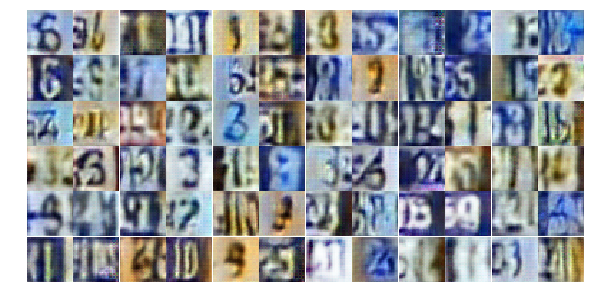

Epoch 8/24... Discriminator Loss: 0.7467... Generator Loss: 1.5255
Epoch 8/24... Discriminator Loss: 0.5662... Generator Loss: 2.5015
Epoch 8/24... Discriminator Loss: 1.2762... Generator Loss: 0.5032
Epoch 8/24... Discriminator Loss: 1.2386... Generator Loss: 0.7321
Epoch 8/24... Discriminator Loss: 0.9288... Generator Loss: 1.6181
Epoch 8/24... Discriminator Loss: 0.6992... Generator Loss: 1.6238
Epoch 8/24... Discriminator Loss: 1.0280... Generator Loss: 1.0234
Epoch 8/24... Discriminator Loss: 1.2161... Generator Loss: 0.9727
Epoch 9/24... Discriminator Loss: 1.3824... Generator Loss: 0.5711
Epoch 9/24... Discriminator Loss: 1.0566... Generator Loss: 0.6755


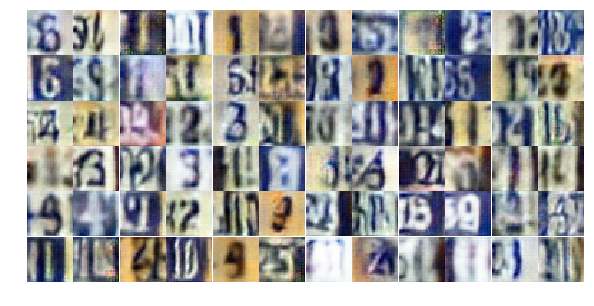

Epoch 9/24... Discriminator Loss: 0.8424... Generator Loss: 1.3462
Epoch 9/24... Discriminator Loss: 2.2427... Generator Loss: 0.3375
Epoch 9/24... Discriminator Loss: 1.2701... Generator Loss: 0.7012
Epoch 9/24... Discriminator Loss: 0.6786... Generator Loss: 1.1413
Epoch 9/24... Discriminator Loss: 1.8380... Generator Loss: 1.0132
Epoch 9/24... Discriminator Loss: 1.1011... Generator Loss: 1.2203
Epoch 9/24... Discriminator Loss: 1.0610... Generator Loss: 0.9412
Epoch 9/24... Discriminator Loss: 1.0597... Generator Loss: 0.6852
Epoch 9/24... Discriminator Loss: 1.1709... Generator Loss: 0.6538
Epoch 9/24... Discriminator Loss: 1.0039... Generator Loss: 0.8978


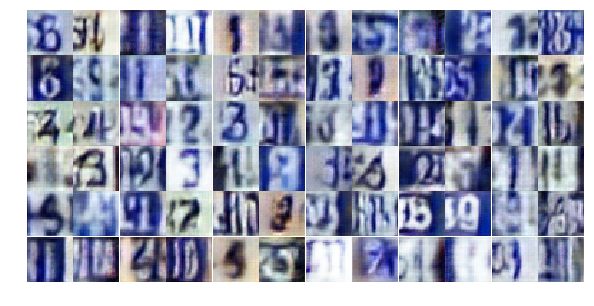

Epoch 9/24... Discriminator Loss: 1.2393... Generator Loss: 0.8695
Epoch 9/24... Discriminator Loss: 3.1685... Generator Loss: 0.0592
Epoch 9/24... Discriminator Loss: 1.0966... Generator Loss: 0.6192
Epoch 9/24... Discriminator Loss: 1.0323... Generator Loss: 0.8154
Epoch 9/24... Discriminator Loss: 0.9118... Generator Loss: 1.4148
Epoch 9/24... Discriminator Loss: 1.0711... Generator Loss: 0.6531
Epoch 9/24... Discriminator Loss: 1.4257... Generator Loss: 0.4602
Epoch 9/24... Discriminator Loss: 1.4286... Generator Loss: 0.4349
Epoch 9/24... Discriminator Loss: 1.1466... Generator Loss: 0.9004
Epoch 9/24... Discriminator Loss: 0.9096... Generator Loss: 0.9610


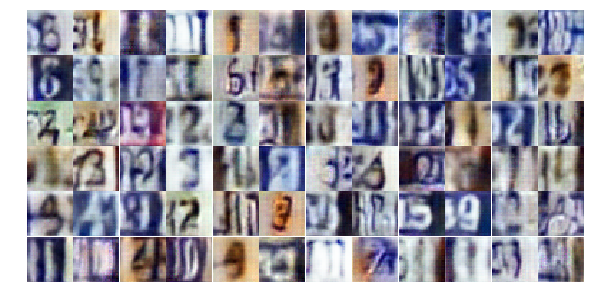

Epoch 9/24... Discriminator Loss: 1.1294... Generator Loss: 0.8135
Epoch 9/24... Discriminator Loss: 1.1883... Generator Loss: 0.4823
Epoch 9/24... Discriminator Loss: 0.5150... Generator Loss: 1.8322
Epoch 9/24... Discriminator Loss: 0.9943... Generator Loss: 1.7613
Epoch 9/24... Discriminator Loss: 1.0775... Generator Loss: 0.5991
Epoch 9/24... Discriminator Loss: 0.5877... Generator Loss: 2.4339
Epoch 9/24... Discriminator Loss: 1.0084... Generator Loss: 1.8420
Epoch 9/24... Discriminator Loss: 0.5056... Generator Loss: 2.8901
Epoch 9/24... Discriminator Loss: 0.9133... Generator Loss: 1.8157
Epoch 9/24... Discriminator Loss: 0.9833... Generator Loss: 1.3057


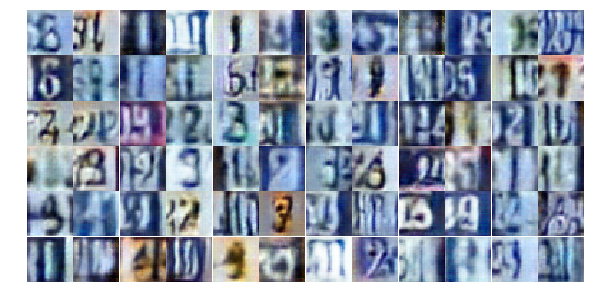

Epoch 9/24... Discriminator Loss: 1.1442... Generator Loss: 0.7567
Epoch 9/24... Discriminator Loss: 1.2724... Generator Loss: 0.6988
Epoch 9/24... Discriminator Loss: 1.1905... Generator Loss: 0.6433
Epoch 9/24... Discriminator Loss: 1.0949... Generator Loss: 0.7391
Epoch 9/24... Discriminator Loss: 0.8168... Generator Loss: 1.0983
Epoch 9/24... Discriminator Loss: 1.7659... Generator Loss: 0.2402
Epoch 9/24... Discriminator Loss: 0.1162... Generator Loss: 2.9265
Epoch 9/24... Discriminator Loss: 0.3193... Generator Loss: 1.9159
Epoch 9/24... Discriminator Loss: 2.2537... Generator Loss: 1.1561
Epoch 9/24... Discriminator Loss: 1.2177... Generator Loss: 0.7778


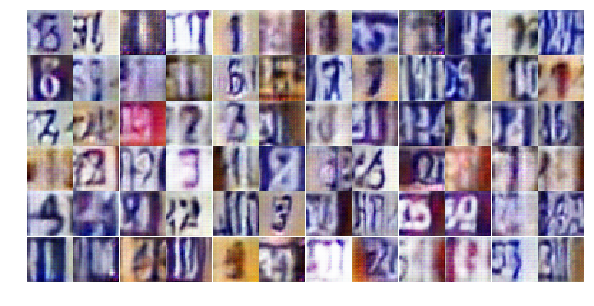

Epoch 9/24... Discriminator Loss: 0.9157... Generator Loss: 1.2300
Epoch 9/24... Discriminator Loss: 1.2794... Generator Loss: 0.6944
Epoch 9/24... Discriminator Loss: 1.0039... Generator Loss: 0.8963
Epoch 9/24... Discriminator Loss: 1.1309... Generator Loss: 1.0368
Epoch 9/24... Discriminator Loss: 0.9598... Generator Loss: 0.9593
Epoch 9/24... Discriminator Loss: 1.2163... Generator Loss: 0.6911
Epoch 9/24... Discriminator Loss: 0.9660... Generator Loss: 0.8990
Epoch 9/24... Discriminator Loss: 1.2085... Generator Loss: 0.6287
Epoch 9/24... Discriminator Loss: 1.2333... Generator Loss: 0.7720
Epoch 9/24... Discriminator Loss: 1.1893... Generator Loss: 1.0973


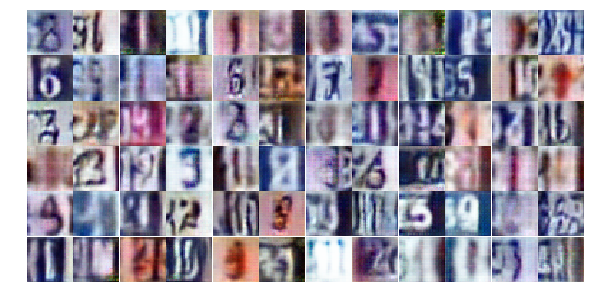

Epoch 9/24... Discriminator Loss: 1.2385... Generator Loss: 0.6103
Epoch 9/24... Discriminator Loss: 1.1495... Generator Loss: 0.9480
Epoch 9/24... Discriminator Loss: 1.0913... Generator Loss: 0.7689
Epoch 9/24... Discriminator Loss: 1.1108... Generator Loss: 0.7002
Epoch 9/24... Discriminator Loss: 1.0624... Generator Loss: 0.9051
Epoch 10/24... Discriminator Loss: 1.1184... Generator Loss: 0.7627
Epoch 10/24... Discriminator Loss: 1.1250... Generator Loss: 0.8108
Epoch 10/24... Discriminator Loss: 1.1775... Generator Loss: 0.5786
Epoch 10/24... Discriminator Loss: 1.1569... Generator Loss: 0.6264
Epoch 10/24... Discriminator Loss: 1.3216... Generator Loss: 0.4853


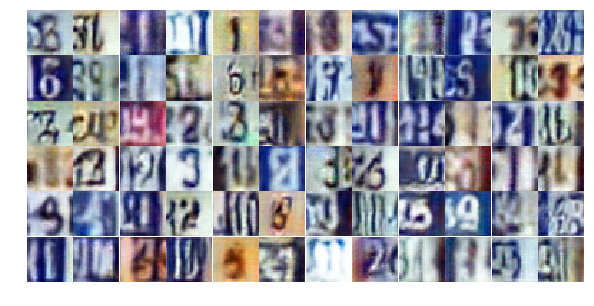

Epoch 10/24... Discriminator Loss: 1.2340... Generator Loss: 0.5952
Epoch 10/24... Discriminator Loss: 0.9454... Generator Loss: 1.0074
Epoch 10/24... Discriminator Loss: 1.0813... Generator Loss: 0.8243
Epoch 10/24... Discriminator Loss: 1.1368... Generator Loss: 0.8523
Epoch 10/24... Discriminator Loss: 1.1239... Generator Loss: 0.9182
Epoch 10/24... Discriminator Loss: 1.0713... Generator Loss: 0.9078
Epoch 10/24... Discriminator Loss: 1.0374... Generator Loss: 1.0185
Epoch 10/24... Discriminator Loss: 1.3993... Generator Loss: 0.4703
Epoch 10/24... Discriminator Loss: 1.3155... Generator Loss: 0.7174
Epoch 10/24... Discriminator Loss: 1.0196... Generator Loss: 1.3119


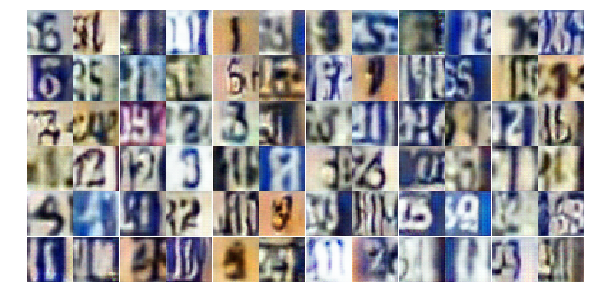

Epoch 10/24... Discriminator Loss: 1.1835... Generator Loss: 0.7427
Epoch 10/24... Discriminator Loss: 1.5245... Generator Loss: 0.4454
Epoch 10/24... Discriminator Loss: 1.0417... Generator Loss: 0.7939
Epoch 10/24... Discriminator Loss: 1.4387... Generator Loss: 0.4949
Epoch 10/24... Discriminator Loss: 1.0089... Generator Loss: 0.9364
Epoch 10/24... Discriminator Loss: 1.1933... Generator Loss: 0.6630
Epoch 10/24... Discriminator Loss: 1.0874... Generator Loss: 0.8061
Epoch 10/24... Discriminator Loss: 1.0173... Generator Loss: 0.7784
Epoch 10/24... Discriminator Loss: 1.3167... Generator Loss: 0.4972
Epoch 10/24... Discriminator Loss: 0.8128... Generator Loss: 1.2380


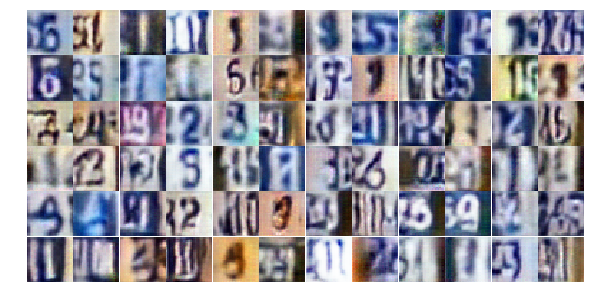

Epoch 10/24... Discriminator Loss: 1.1787... Generator Loss: 0.7068
Epoch 10/24... Discriminator Loss: 1.2076... Generator Loss: 0.8103
Epoch 10/24... Discriminator Loss: 1.0168... Generator Loss: 1.2595
Epoch 10/24... Discriminator Loss: 1.1446... Generator Loss: 1.7152
Epoch 10/24... Discriminator Loss: 1.3411... Generator Loss: 0.4307
Epoch 10/24... Discriminator Loss: 1.1068... Generator Loss: 0.6729
Epoch 10/24... Discriminator Loss: 0.9557... Generator Loss: 0.9761
Epoch 10/24... Discriminator Loss: 1.2377... Generator Loss: 0.5334
Epoch 10/24... Discriminator Loss: 0.9916... Generator Loss: 0.8221
Epoch 10/24... Discriminator Loss: 1.3775... Generator Loss: 0.4449


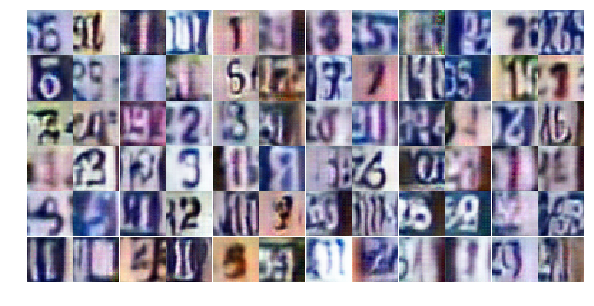

Epoch 10/24... Discriminator Loss: 1.3397... Generator Loss: 0.6587
Epoch 10/24... Discriminator Loss: 1.2888... Generator Loss: 0.6205
Epoch 10/24... Discriminator Loss: 1.0764... Generator Loss: 0.7274
Epoch 10/24... Discriminator Loss: 1.2871... Generator Loss: 0.9244
Epoch 10/24... Discriminator Loss: 1.1573... Generator Loss: 0.7146
Epoch 10/24... Discriminator Loss: 1.0780... Generator Loss: 0.8025
Epoch 10/24... Discriminator Loss: 1.0461... Generator Loss: 0.8044
Epoch 10/24... Discriminator Loss: 1.1418... Generator Loss: 0.6714
Epoch 10/24... Discriminator Loss: 1.1307... Generator Loss: 0.7047
Epoch 10/24... Discriminator Loss: 1.7172... Generator Loss: 1.4456


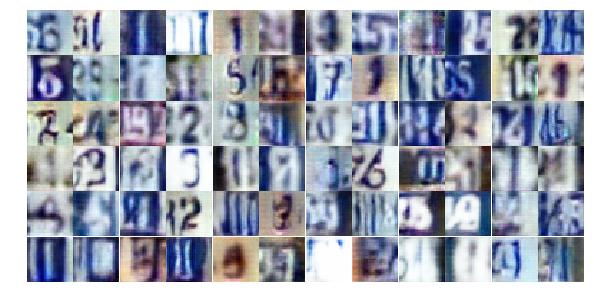

Epoch 10/24... Discriminator Loss: 1.2068... Generator Loss: 0.5441
Epoch 10/24... Discriminator Loss: 1.1114... Generator Loss: 0.8101
Epoch 10/24... Discriminator Loss: 1.2418... Generator Loss: 0.5829
Epoch 10/24... Discriminator Loss: 0.9092... Generator Loss: 0.9654
Epoch 10/24... Discriminator Loss: 0.9950... Generator Loss: 1.0750
Epoch 10/24... Discriminator Loss: 1.3553... Generator Loss: 0.5172
Epoch 10/24... Discriminator Loss: 1.1140... Generator Loss: 1.0193
Epoch 10/24... Discriminator Loss: 0.9558... Generator Loss: 1.1079
Epoch 10/24... Discriminator Loss: 0.9744... Generator Loss: 0.9600
Epoch 10/24... Discriminator Loss: 0.9829... Generator Loss: 0.9527


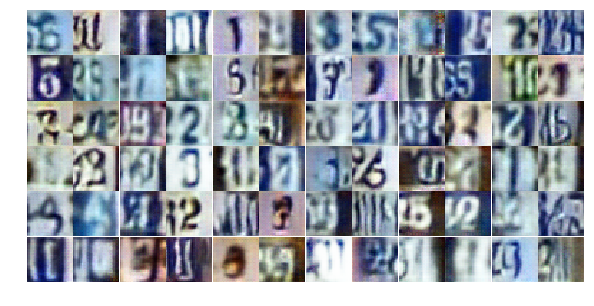

Epoch 10/24... Discriminator Loss: 1.4295... Generator Loss: 0.4549
Epoch 10/24... Discriminator Loss: 0.9719... Generator Loss: 0.7878
Epoch 10/24... Discriminator Loss: 0.9962... Generator Loss: 0.7297
Epoch 11/24... Discriminator Loss: 1.2381... Generator Loss: 1.1591
Epoch 11/24... Discriminator Loss: 1.0368... Generator Loss: 0.8202
Epoch 11/24... Discriminator Loss: 1.4070... Generator Loss: 0.4998
Epoch 11/24... Discriminator Loss: 1.4379... Generator Loss: 0.3984
Epoch 11/24... Discriminator Loss: 0.9331... Generator Loss: 1.3632
Epoch 11/24... Discriminator Loss: 1.3035... Generator Loss: 0.5221
Epoch 11/24... Discriminator Loss: 0.9010... Generator Loss: 0.9823


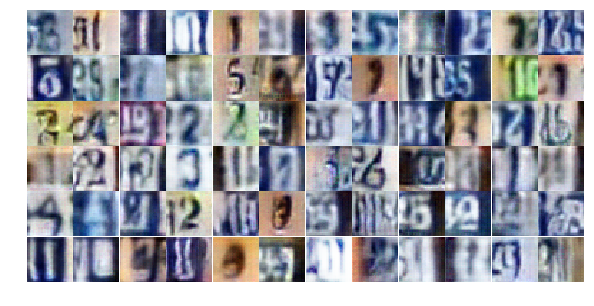

Epoch 11/24... Discriminator Loss: 1.0099... Generator Loss: 1.0662
Epoch 11/24... Discriminator Loss: 1.1785... Generator Loss: 0.6270
Epoch 11/24... Discriminator Loss: 0.8791... Generator Loss: 0.8459
Epoch 11/24... Discriminator Loss: 1.5240... Generator Loss: 0.3598
Epoch 11/24... Discriminator Loss: 1.3790... Generator Loss: 0.4384
Epoch 11/24... Discriminator Loss: 1.0439... Generator Loss: 0.7154
Epoch 11/24... Discriminator Loss: 1.0644... Generator Loss: 0.7551
Epoch 11/24... Discriminator Loss: 0.8008... Generator Loss: 1.1086
Epoch 11/24... Discriminator Loss: 1.1009... Generator Loss: 0.6657
Epoch 11/24... Discriminator Loss: 1.2921... Generator Loss: 0.4905


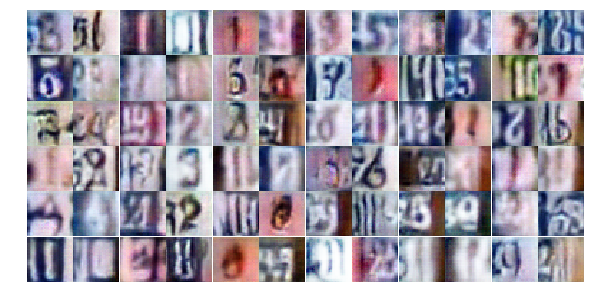

Epoch 11/24... Discriminator Loss: 1.4287... Generator Loss: 0.8554
Epoch 11/24... Discriminator Loss: 0.3419... Generator Loss: 1.4998
Epoch 11/24... Discriminator Loss: 1.5797... Generator Loss: 0.3336
Epoch 11/24... Discriminator Loss: 1.5343... Generator Loss: 1.1814
Epoch 11/24... Discriminator Loss: 0.6455... Generator Loss: 1.3933
Epoch 11/24... Discriminator Loss: 0.4275... Generator Loss: 3.1256
Epoch 11/24... Discriminator Loss: 1.0168... Generator Loss: 0.6095
Epoch 11/24... Discriminator Loss: 1.3759... Generator Loss: 1.7583
Epoch 11/24... Discriminator Loss: 1.2991... Generator Loss: 1.4596
Epoch 11/24... Discriminator Loss: 1.0862... Generator Loss: 0.8165


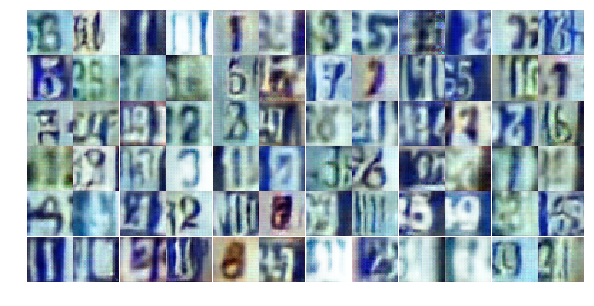

Epoch 11/24... Discriminator Loss: 1.3118... Generator Loss: 0.6521
Epoch 11/24... Discriminator Loss: 1.1414... Generator Loss: 0.7814
Epoch 11/24... Discriminator Loss: 1.1523... Generator Loss: 0.7092
Epoch 11/24... Discriminator Loss: 1.0207... Generator Loss: 0.7802
Epoch 11/24... Discriminator Loss: 1.2253... Generator Loss: 0.6526
Epoch 11/24... Discriminator Loss: 1.1494... Generator Loss: 0.7910
Epoch 11/24... Discriminator Loss: 1.3804... Generator Loss: 0.4900
Epoch 11/24... Discriminator Loss: 1.3166... Generator Loss: 0.4741
Epoch 11/24... Discriminator Loss: 1.2974... Generator Loss: 0.5281
Epoch 11/24... Discriminator Loss: 1.0718... Generator Loss: 1.1618


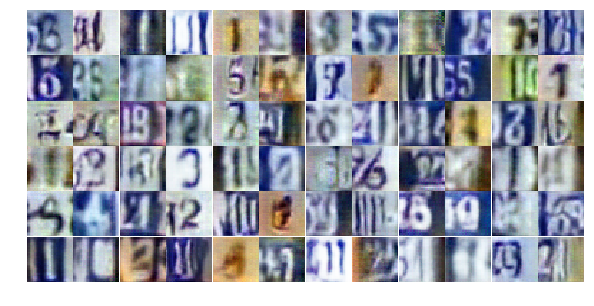

Epoch 11/24... Discriminator Loss: 0.9227... Generator Loss: 0.9021
Epoch 11/24... Discriminator Loss: 0.9408... Generator Loss: 0.8926
Epoch 11/24... Discriminator Loss: 1.2271... Generator Loss: 0.5869
Epoch 11/24... Discriminator Loss: 1.2201... Generator Loss: 0.9933
Epoch 11/24... Discriminator Loss: 0.9843... Generator Loss: 0.8315
Epoch 11/24... Discriminator Loss: 0.9991... Generator Loss: 0.7404
Epoch 11/24... Discriminator Loss: 0.6160... Generator Loss: 1.7391
Epoch 11/24... Discriminator Loss: 1.2348... Generator Loss: 0.5130
Epoch 11/24... Discriminator Loss: 1.3577... Generator Loss: 1.3680
Epoch 11/24... Discriminator Loss: 0.7197... Generator Loss: 1.0937


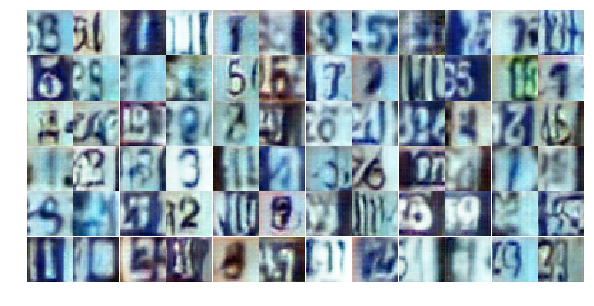

Epoch 11/24... Discriminator Loss: 1.1141... Generator Loss: 0.8220
Epoch 11/24... Discriminator Loss: 0.7666... Generator Loss: 0.9180
Epoch 11/24... Discriminator Loss: 0.5830... Generator Loss: 1.1223
Epoch 11/24... Discriminator Loss: 0.3133... Generator Loss: 2.0232
Epoch 11/24... Discriminator Loss: 1.4947... Generator Loss: 1.0553
Epoch 11/24... Discriminator Loss: 0.9902... Generator Loss: 1.2543
Epoch 11/24... Discriminator Loss: 1.2783... Generator Loss: 0.5679
Epoch 11/24... Discriminator Loss: 0.9243... Generator Loss: 1.1104
Epoch 11/24... Discriminator Loss: 1.1492... Generator Loss: 0.6455
Epoch 11/24... Discriminator Loss: 0.9261... Generator Loss: 0.8535


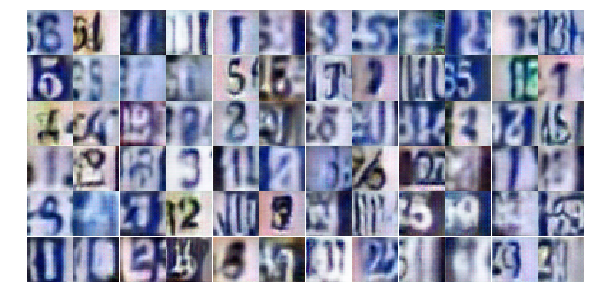

Epoch 12/24... Discriminator Loss: 1.0964... Generator Loss: 0.8166
Epoch 12/24... Discriminator Loss: 1.0128... Generator Loss: 0.7006
Epoch 12/24... Discriminator Loss: 1.1590... Generator Loss: 0.6119
Epoch 12/24... Discriminator Loss: 0.8808... Generator Loss: 1.0509
Epoch 12/24... Discriminator Loss: 1.0571... Generator Loss: 0.7520
Epoch 12/24... Discriminator Loss: 1.0205... Generator Loss: 0.6798
Epoch 12/24... Discriminator Loss: 1.0499... Generator Loss: 0.6580
Epoch 12/24... Discriminator Loss: 0.9118... Generator Loss: 0.8781
Epoch 12/24... Discriminator Loss: 0.9902... Generator Loss: 1.1561
Epoch 12/24... Discriminator Loss: 1.2666... Generator Loss: 0.5359


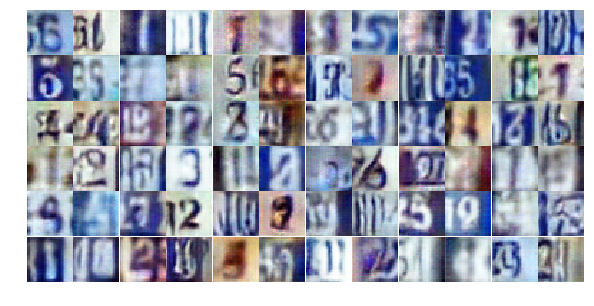

Epoch 12/24... Discriminator Loss: 0.9821... Generator Loss: 1.1422
Epoch 12/24... Discriminator Loss: 1.2952... Generator Loss: 0.5396
Epoch 12/24... Discriminator Loss: 0.8535... Generator Loss: 0.8365
Epoch 12/24... Discriminator Loss: 0.9878... Generator Loss: 0.9903
Epoch 12/24... Discriminator Loss: 0.7362... Generator Loss: 1.9430
Epoch 12/24... Discriminator Loss: 1.8690... Generator Loss: 0.3081
Epoch 12/24... Discriminator Loss: 1.8766... Generator Loss: 0.2163
Epoch 12/24... Discriminator Loss: 0.4166... Generator Loss: 1.6336
Epoch 12/24... Discriminator Loss: 1.0882... Generator Loss: 1.3793
Epoch 12/24... Discriminator Loss: 1.3816... Generator Loss: 0.5981


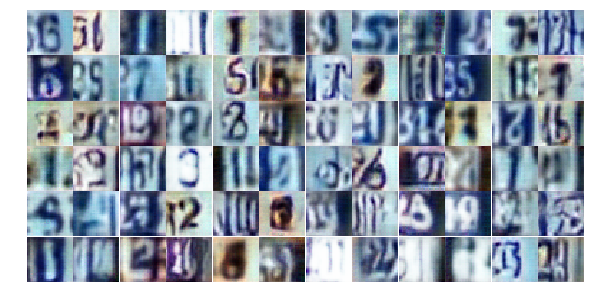

Epoch 12/24... Discriminator Loss: 0.8046... Generator Loss: 0.9882
Epoch 12/24... Discriminator Loss: 1.0532... Generator Loss: 0.7753
Epoch 12/24... Discriminator Loss: 1.1233... Generator Loss: 0.6188
Epoch 12/24... Discriminator Loss: 0.7631... Generator Loss: 1.2962
Epoch 12/24... Discriminator Loss: 0.8671... Generator Loss: 0.9006
Epoch 12/24... Discriminator Loss: 0.6380... Generator Loss: 1.2669
Epoch 12/24... Discriminator Loss: 0.9595... Generator Loss: 0.8383
Epoch 12/24... Discriminator Loss: 0.5217... Generator Loss: 1.8332
Epoch 12/24... Discriminator Loss: 0.6406... Generator Loss: 1.7414
Epoch 12/24... Discriminator Loss: 0.7472... Generator Loss: 0.7813


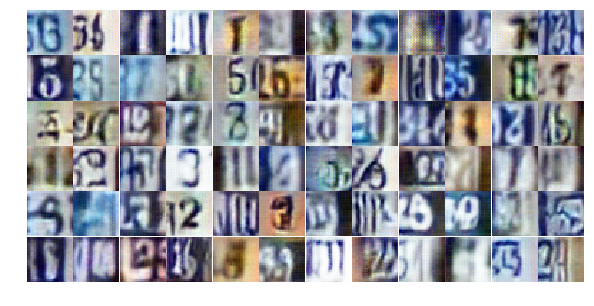

Epoch 12/24... Discriminator Loss: 1.5517... Generator Loss: 0.3730
Epoch 12/24... Discriminator Loss: 1.3391... Generator Loss: 0.4448
Epoch 12/24... Discriminator Loss: 1.0016... Generator Loss: 0.7753
Epoch 12/24... Discriminator Loss: 1.4193... Generator Loss: 0.4564
Epoch 12/24... Discriminator Loss: 0.2722... Generator Loss: 5.4033
Epoch 12/24... Discriminator Loss: 2.8633... Generator Loss: 3.1692
Epoch 12/24... Discriminator Loss: 1.2143... Generator Loss: 0.7507
Epoch 12/24... Discriminator Loss: 1.1610... Generator Loss: 0.8100
Epoch 12/24... Discriminator Loss: 1.0677... Generator Loss: 1.3660
Epoch 12/24... Discriminator Loss: 0.9943... Generator Loss: 0.9790


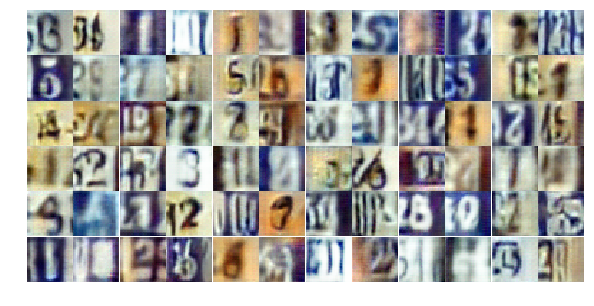

Epoch 12/24... Discriminator Loss: 0.7883... Generator Loss: 1.1014
Epoch 12/24... Discriminator Loss: 1.0350... Generator Loss: 0.8690
Epoch 12/24... Discriminator Loss: 0.8948... Generator Loss: 1.0013
Epoch 12/24... Discriminator Loss: 1.1793... Generator Loss: 0.8288
Epoch 12/24... Discriminator Loss: 1.0434... Generator Loss: 0.7539
Epoch 12/24... Discriminator Loss: 1.3552... Generator Loss: 0.6628
Epoch 12/24... Discriminator Loss: 1.0288... Generator Loss: 0.8612
Epoch 12/24... Discriminator Loss: 1.1595... Generator Loss: 0.6024
Epoch 12/24... Discriminator Loss: 0.8590... Generator Loss: 0.8894
Epoch 12/24... Discriminator Loss: 1.0094... Generator Loss: 0.7394


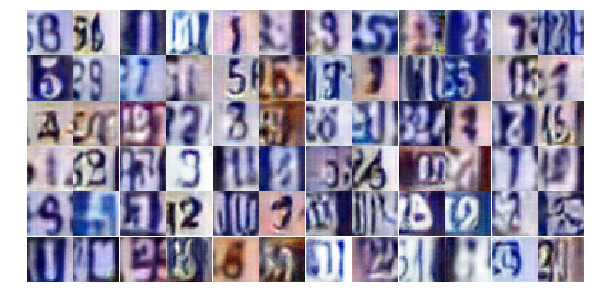

Epoch 12/24... Discriminator Loss: 1.1240... Generator Loss: 0.6999
Epoch 12/24... Discriminator Loss: 0.9298... Generator Loss: 0.8872
Epoch 12/24... Discriminator Loss: 0.9469... Generator Loss: 0.9233
Epoch 12/24... Discriminator Loss: 1.0374... Generator Loss: 0.9232
Epoch 12/24... Discriminator Loss: 1.1131... Generator Loss: 0.6705
Epoch 12/24... Discriminator Loss: 1.0211... Generator Loss: 0.9767
Epoch 12/24... Discriminator Loss: 1.2414... Generator Loss: 0.5430
Epoch 13/24... Discriminator Loss: 0.8571... Generator Loss: 1.0057
Epoch 13/24... Discriminator Loss: 0.9081... Generator Loss: 1.0701
Epoch 13/24... Discriminator Loss: 1.0631... Generator Loss: 0.8307


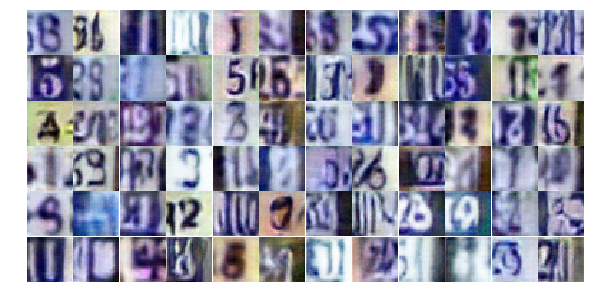

Epoch 13/24... Discriminator Loss: 1.0128... Generator Loss: 0.9346
Epoch 13/24... Discriminator Loss: 1.0269... Generator Loss: 1.0476
Epoch 13/24... Discriminator Loss: 1.5844... Generator Loss: 0.3432
Epoch 13/24... Discriminator Loss: 1.1680... Generator Loss: 0.5584
Epoch 13/24... Discriminator Loss: 0.9188... Generator Loss: 0.9607
Epoch 13/24... Discriminator Loss: 0.9080... Generator Loss: 1.1792
Epoch 13/24... Discriminator Loss: 0.9057... Generator Loss: 1.2941
Epoch 13/24... Discriminator Loss: 1.1987... Generator Loss: 0.5311
Epoch 13/24... Discriminator Loss: 1.0075... Generator Loss: 0.7863
Epoch 13/24... Discriminator Loss: 0.9655... Generator Loss: 0.9606


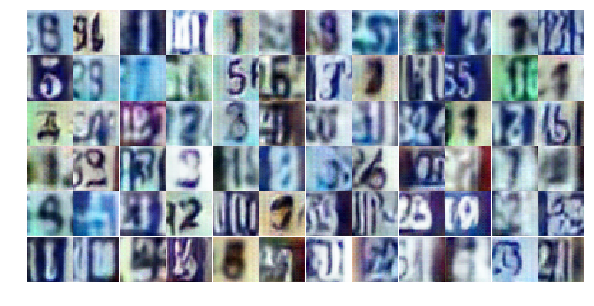

Epoch 13/24... Discriminator Loss: 1.0614... Generator Loss: 0.6838
Epoch 13/24... Discriminator Loss: 0.9315... Generator Loss: 1.0014
Epoch 13/24... Discriminator Loss: 1.4283... Generator Loss: 0.4296
Epoch 13/24... Discriminator Loss: 0.9503... Generator Loss: 0.9573
Epoch 13/24... Discriminator Loss: 1.1481... Generator Loss: 0.8029
Epoch 13/24... Discriminator Loss: 1.1276... Generator Loss: 0.7595
Epoch 13/24... Discriminator Loss: 0.9689... Generator Loss: 0.7384
Epoch 13/24... Discriminator Loss: 1.1393... Generator Loss: 0.7714


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))